### Import packages

In [72]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import copy
import math

%matplotlib inline

In [2]:
# pip install ydata-profiling
from ydata_profiling import ProfileReport

### Read data

In [73]:
data = pd.read_csv("churn-tele-small.csv", thousands=',', skipinitialspace=True)
#data = pd.read_csv("churn-bigml-80.csv", thousands=',', skipinitialspace=True)
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,LA,117,408,No,No,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
1,IN,65,415,No,No,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True
2,NY,161,415,No,No,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True
3,SC,111,415,No,No,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,False
4,HI,49,510,No,No,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,WI,114,415,No,Yes,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,False
663,AL,106,408,No,Yes,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,False
664,VT,60,415,No,No,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,False
665,WV,159,415,No,No,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,False


### Drop empty lines in data and remove NAN's

In [74]:
data = data.dropna()
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,LA,117,408,No,No,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
1,IN,65,415,No,No,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True
2,NY,161,415,No,No,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True
3,SC,111,415,No,No,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,False
4,HI,49,510,No,No,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,WI,114,415,No,Yes,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,False
663,AL,106,408,No,Yes,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,False
664,VT,60,415,No,No,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,False
665,WV,159,415,No,No,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,False


### Reset the index for potentially removed rows in data

In [75]:
data = data.reset_index(drop=True)

## EDA - Exploratory Data Analysis

### View data statistics - short format

In [76]:
data.describe()

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
count,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000
mean,102.841079,436.157421,8.407796,180.948126,100.937031,30.761769,203.355322,100.476762,17.285262,199.685307,100.113943,8.985907,10.238381,4.527736,2.764948,1.563718
std,40.819480,41.783305,13.994480,55.508628,20.396790,9.436463,49.719268,18.948262,4.226160,49.759931,20.172505,2.239429,2.807850,2.482442,0.758167,1.333357
min,1.000000,408.000000,0.000000,25.900000,30.000000,4.400000,48.100000,37.000000,4.090000,23.200000,42.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,76.000000,408.000000,0.000000,146.250000,87.500000,24.860000,171.050000,88.000000,14.540000,167.950000,86.000000,7.560000,8.600000,3.000000,2.320000,1.000000
50%,102.000000,415.000000,0.000000,178.300000,101.000000,30.310000,203.700000,101.000000,17.310000,201.600000,100.000000,9.070000,10.500000,4.000000,2.840000,1.000000
75%,128.000000,415.000000,20.000000,220.700000,115.000000,37.520000,236.450000,113.000000,20.095000,231.500000,113.500000,10.420000,12.050000,6.000000,3.255000,2.000000
max,232.000000,510.000000,51.000000,334.300000,165.000000,56.830000,361.800000,168.000000,30.750000,367.700000,175.000000,16.550000,18.300000,18.000000,4.940000,8.000000


### View data statistics - long format

In [7]:
profile = ProfileReport(data, title="Telecom Customer Churn")

In [8]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:01<00:00, 19.00it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Important: We have 85.8% samples with no churn and 14.2% churn samples in our dataset

### Change categorical string/boolean columns to categorical integer columns

In [77]:
data['State'] = data['State'].astype('category').cat.codes
data['International plan'] = data['International plan'].astype('category').cat.codes
data['Voice mail plan'] = data['Voice mail plan'].astype('category').cat.codes
data['Churn'] = data['Churn'].astype('category').cat.codes

In [78]:
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,18,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,0
1,15,65,415,0,0,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,1
2,34,161,415,0,0,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,1
3,40,111,415,0,0,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,0
4,11,49,510,0,0,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48,114,415,0,1,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,0
663,1,106,408,0,1,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,0
664,46,60,415,0,0,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,0
665,49,159,415,0,0,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,0


### Create x and y from original data

In [79]:
x_data = data.drop(columns=['Churn'])
x_data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
0,18,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1
1,15,65,415,0,0,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4
2,34,161,415,0,0,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4
3,40,111,415,0,0,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2
4,11,49,510,0,0,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48,114,415,0,1,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2
663,1,106,408,0,1,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1
664,46,60,415,0,0,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3
665,49,159,415,0,0,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1


In [80]:
y_data = data[['Churn']]
y_data

,Churn
0,0
1,1
2,1
3,0
4,0
...,...
662,0
663,0
664,0
665,0


### View features against Churn

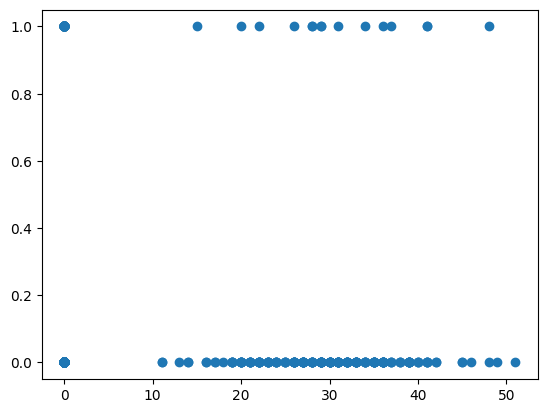

In [81]:
plt.scatter(x_data['Number vmail messages'], y_data)

### Split data into training and validation datasets: Default 80% train, 20% validation

In [327]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

### Visualize how one sample looks like

In [ ]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

In [123]:
x_train[0]

array([ 32.  , 178.  , 415.  ,   0.  ,   1.  ,  35.  , 175.4 ,  88.  ,
        29.82, 190.  ,  65.  ,  16.15, 138.7 ,  94.  ,   6.24,  10.5 ,
         3.  ,   2.84,   2.  ])

### Visualize the nuber of training samples and number of validation samples

In [124]:
len(y_train), len(y_validation)

(533, 134)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [125]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([457,  76]))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [126]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([115,  19]))

### Standardization - mean and standard deviation calculation

In [127]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)

In [128]:
x_train = (x_train - mean) / sigma

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [129]:
x_validation = (x_validation - mean) / sigma

### View min and max values after standardization from training dataset

In [130]:
x_train.min(), x_train.max()

(np.float64(-3.5984680421433746), np.float64(5.4125190859663475))

### View min and max values after standardization from training dataset

In [131]:
x_validation.min(), x_validation.max()

(np.float64(-3.3844981071308844), np.float64(4.792063484973815))

### Logistic Regression implementation

In [132]:
def sigmoid(x):
    g = 1 / (1 + np.exp(-x))
    return g

#### Examples of using sigmoid values

In [133]:
sigmoid(1)

np.float64(0.7310585786300049)

In [134]:
sigmoid(0)

np.float64(0.5)

In [135]:
sigmoid(-1)

np.float64(0.2689414213699951)

In [136]:
sigmoid(-1000)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\3992194360.py:2: RuntimeWarning: overflow encountered in exp
  g = 1 / (1 + np.exp(-x))


np.float64(0.0)

In [137]:
sigmoid(100)

np.float64(1.0)

In [138]:
def compute_cost(X, y, w, b, lambda_=1):
    m = X.shape[0]
    cost = 0.0
    for i in range(m):
        z_i = np.dot(X[i],w) + b
        f_wb_i = sigmoid(z_i)
        cost +=  -y[i] * np.log(f_wb_i) - (1 - y[i]) * np.log(1 - f_wb_i) 
             
    cost = cost / m
    return cost

In [139]:
def compute_gradient(X, y, w, b, lambda_=1):
    m,n = X.shape
    dj_dw = np.zeros((n,))                           #(n,)
    dj_db = 0.

    for i in range(m):
        f_wb_i = sigmoid(np.dot(X[i], w) + b)          #(n,)(n,)=scalar
        err_i  = f_wb_i  - y[i]                       #scalar
        for j in range(n):
            dj_dw[j] += err_i * X[i,j]      #scalar
        dj_db += err_i
    dj_dw = dj_dw/m                                   #(n,)
    dj_db = dj_db/m                                   #scalar
        
    return dj_db, dj_dw

In [140]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [141]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 1000
alpha = 3
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\2253367060.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  dj_dw[j] += err_i * X[i,j]      #scalar


Iteration    0: Cost Train: 0.389368 	  Cost Validation: 0.381698
Iteration  100: Cost Train: 0.302328 	  Cost Validation: 0.328563
Iteration  200: Cost Train: 0.302327 	  Cost Validation: 0.328637
Iteration  300: Cost Train: 0.302327 	  Cost Validation: 0.328670
Iteration  400: Cost Train: 0.302327 	  Cost Validation: 0.328686
Iteration  500: Cost Train: 0.302327 	  Cost Validation: 0.328692
Iteration  600: Cost Train: 0.302327 	  Cost Validation: 0.328695
Iteration  700: Cost Train: 0.302327 	  Cost Validation: 0.328697
Iteration  800: Cost Train: 0.302327 	  Cost Validation: 0.328697
Iteration  900: Cost Train: 0.302327 	  Cost Validation: 0.328697
Iteration  999: Cost Train: 0.302327 	  Cost Validation: 0.328697


In [142]:
best_w_final = np.load('model/best_valid_w_in.npy')
best_b_final = np.load('model/best_valid_b.npy')

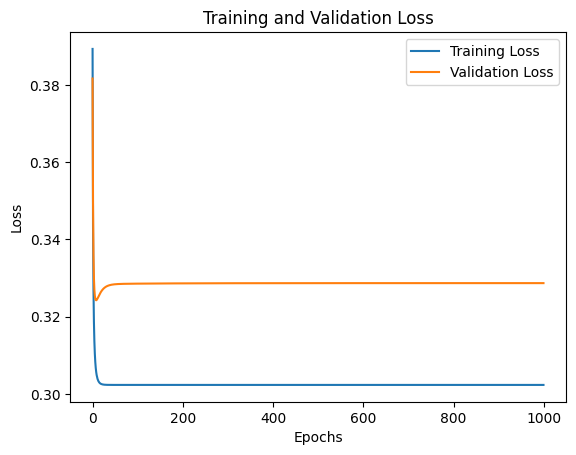

In [143]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [144]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [145]:
y_predicted = predict(x_train, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [146]:
y_train.shape

(533, 1)

In [147]:
y_train.reshape(-1).shape, y_predicted.shape

((533,), (533,))

In [148]:
(y_train.reshape(-1) == y_predicted).sum()

np.int64(462)

In [149]:
x_train.shape
x_train.shape

(533, 19)

In [150]:
y_train = y_train.reshape(-1)

In [151]:
type(y_predicted)

numpy.ndarray

In [152]:
def metrics_computations(x:np.array,
                         y_true:np.array,
                         y_predicted: np.array):
    total_number_of_samples = x.shape[0]
    accuracy = (y_true == y_predicted).sum() / total_number_of_samples
    true_positive = ((y_predicted == 1) & (y_true == 1)).sum()
    false_positive = ((y_predicted == 1) & (y_true == 0)).sum()
    false_negative = ((y_predicted == 0) & (y_true == 1)).sum()
    true_negative = ((y_predicted == 0) & (y_true == 0)).sum()
    
    precision = true_positive / (true_positive + false_positive)
    recall = true_positive / (true_positive + false_negative)
    specificity = true_negative / (true_negative + false_positive)
    f1_score = (2 * precision * recall) / (precision + recall)
    
    false_negative_rate = false_negative / (false_negative + true_positive)
    false_positive_rate = false_positive / (false_positive + true_negative)

    return (accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate)

In [153]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [154]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 86.68% 
 Precision: 57.58% 
 Recall: 25.00% 
 F1 Score: 34.86% 
 Specificity: 96.94% 
 False Positive Rate: 3.06% 
 False Negative Rate: 75.00%


In [157]:
y_predicted_validation = predict(x_validation, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [158]:
y_validation = y_validation.reshape(-1)

In [159]:
for i, j in zip(y_validation, y_predicted_validation):
    print(i, j)

0 1.0
1 0.0
0 0.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
0 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 1.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 1.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
1 0.0


In [160]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [161]:
print(f"[Valid] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[Valid] Accuracy: 85.82% 
 Precision: 50.00% 
 Recall: 15.79% 
 F1 Score: 24.00% 
 Specificity: 97.39% 
 False Positive Rate: 2.61% 
 False Negative Rate: 84.21%


### Analyze the feature importance

<Axes: ylabel='Feature'>

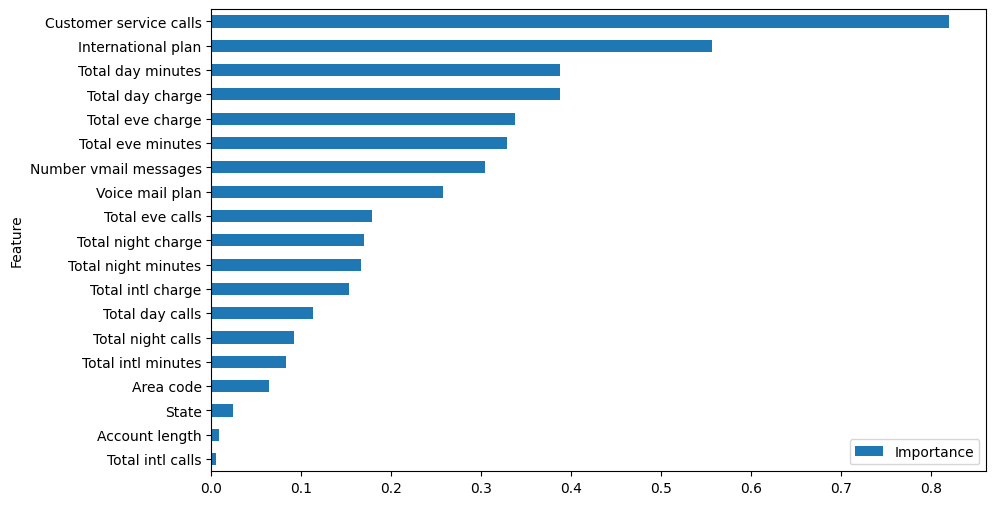

In [162]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

### Add polynomial features for improving model capacity

In [163]:
#pip install scikit-learn
from sklearn import preprocessing

In [164]:
poly = preprocessing.PolynomialFeatures(2, interaction_only=False, include_bias=False)

In [165]:
poly_values = poly.fit_transform(x_data)
poly_values

array([[ 18.    , 117.    , 408.    , ...,   5.5225,   2.35  ,   1.    ],
       [ 15.    ,  65.    , 415.    , ...,  11.7649,  13.72  ,  16.    ],
       [ 34.    , 161.    , 415.    , ...,   2.1316,   5.84  ,  16.    ],
       ...,
       [ 46.    ,  60.    , 415.    , ...,  12.6736,  10.68  ,   9.    ],
       [ 49.    , 159.    , 415.    , ...,   9.7969,   3.13  ,   1.    ],
       [  6.    , 184.    , 510.    , ...,   1.8225,   2.7   ,   4.    ]])

In [166]:
poly_column_names = list(poly.get_feature_names_out(x_data.columns))
poly_column_names

['State',
 'Account length',
 'Area code',
 'International plan',
 'Voice mail plan',
 'Number vmail messages',
 'Total day minutes',
 'Total day calls',
 'Total day charge',
 'Total eve minutes',
 'Total eve calls',
 'Total eve charge',
 'Total night minutes',
 'Total night calls',
 'Total night charge',
 'Total intl minutes',
 'Total intl calls',
 'Total intl charge',
 'Customer service calls',
 'State^2',
 'State Account length',
 'State Area code',
 'State International plan',
 'State Voice mail plan',
 'State Number vmail messages',
 'State Total day minutes',
 'State Total day calls',
 'State Total day charge',
 'State Total eve minutes',
 'State Total eve calls',
 'State Total eve charge',
 'State Total night minutes',
 'State Total night calls',
 'State Total night charge',
 'State Total intl minutes',
 'State Total intl calls',
 'State Total intl charge',
 'State Customer service calls',
 'Account length^2',
 'Account length Area code',
 'Account length International plan',
 '

In [167]:
x_data = pd.DataFrame(poly_values, columns=poly_column_names)
x_data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,...,Total intl minutes^2,Total intl minutes Total intl calls,Total intl minutes Total intl charge,Total intl minutes Customer service calls,Total intl calls^2,Total intl calls Total intl charge,Total intl calls Customer service calls,Total intl charge^2,Total intl charge Customer service calls,Customer service calls^2
0,18.0,117.0,408.0,0.0,0.0,0.0,184.5,97.0,31.37,351.6,...,75.69,34.8,20.445,8.7,16.0,9.40,4.0,5.5225,2.35,1.0
1,15.0,65.0,415.0,0.0,0.0,0.0,129.1,137.0,21.95,228.5,...,161.29,76.2,43.561,50.8,36.0,20.58,24.0,11.7649,13.72,16.0
2,34.0,161.0,415.0,0.0,0.0,0.0,332.9,67.0,56.59,317.8,...,29.16,48.6,7.884,21.6,81.0,13.14,36.0,2.1316,5.84,16.0
3,40.0,111.0,415.0,0.0,0.0,0.0,110.4,103.0,18.77,137.3,...,59.29,46.2,16.016,15.4,36.0,12.48,12.0,4.3264,4.16,4.0
4,11.0,49.0,510.0,0.0,0.0,0.0,119.3,117.0,20.28,215.1,...,123.21,11.1,33.300,11.1,1.0,3.00,1.0,9.0000,3.00,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48.0,114.0,415.0,0.0,1.0,26.0,137.1,88.0,23.31,155.7,...,132.25,80.5,35.765,23.0,49.0,21.77,14.0,9.6721,6.22,4.0
663,1.0,106.0,408.0,0.0,1.0,29.0,83.6,131.0,14.21,203.9,...,65.61,24.3,17.739,8.1,9.0,6.57,3.0,4.7961,2.19,1.0
664,46.0,60.0,415.0,0.0,0.0,0.0,193.9,118.0,32.96,85.0,...,174.24,105.6,46.992,39.6,64.0,28.48,24.0,12.6736,10.68,9.0
665,49.0,159.0,415.0,0.0,0.0,0.0,169.8,114.0,28.87,197.7,...,134.56,46.4,36.308,11.6,16.0,12.52,4.0,9.7969,3.13,1.0


In [168]:
x_data.columns

Index(['State', 'Account length', 'Area code', 'International plan',
       'Voice mail plan', 'Number vmail messages', 'Total day minutes',
       'Total day calls', 'Total day charge', 'Total eve minutes',
       ...
       'Total intl minutes^2', 'Total intl minutes Total intl calls',
       'Total intl minutes Total intl charge',
       'Total intl minutes Customer service calls', 'Total intl calls^2',
       'Total intl calls Total intl charge',
       'Total intl calls Customer service calls', 'Total intl charge^2',
       'Total intl charge Customer service calls', 'Customer service calls^2'],
      dtype='object', length=209)

### Split data into training and validation datasets: Default 80% train, 20% validation

In [169]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

In [171]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

### Visualize how one sample looks like

In [172]:
x_train[0]

array([3.200000e+01, 1.780000e+02, 4.150000e+02, 0.000000e+00,
       1.000000e+00, 3.500000e+01, 1.754000e+02, 8.800000e+01,
       2.982000e+01, 1.900000e+02, 6.500000e+01, 1.615000e+01,
       1.387000e+02, 9.400000e+01, 6.240000e+00, 1.050000e+01,
       3.000000e+00, 2.840000e+00, 2.000000e+00, 1.024000e+03,
       5.696000e+03, 1.328000e+04, 0.000000e+00, 3.200000e+01,
       1.120000e+03, 5.612800e+03, 2.816000e+03, 9.542400e+02,
       6.080000e+03, 2.080000e+03, 5.168000e+02, 4.438400e+03,
       3.008000e+03, 1.996800e+02, 3.360000e+02, 9.600000e+01,
       9.088000e+01, 6.400000e+01, 3.168400e+04, 7.387000e+04,
       0.000000e+00, 1.780000e+02, 6.230000e+03, 3.122120e+04,
       1.566400e+04, 5.307960e+03, 3.382000e+04, 1.157000e+04,
       2.874700e+03, 2.468860e+04, 1.673200e+04, 1.110720e+03,
       1.869000e+03, 5.340000e+02, 5.055200e+02, 3.560000e+02,
       1.722250e+05, 0.000000e+00, 4.150000e+02, 1.452500e+04,
       7.279100e+04, 3.652000e+04, 1.237530e+04, 7.8850

### Visualize the nuber of training samples and number of validation samples

In [173]:
len(y_train), len(y_validation)

(533, 134)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [174]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([457,  76]))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [175]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([115,  19]))

### Standardization - mean and standard deviation calculation

In [176]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)

In [177]:
x_train = (x_train - mean) / sigma

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [178]:
x_validation = (x_validation - mean) / sigma

### View min and max values after standardization from training dataset

In [179]:
x_train.min(), x_train.max()

(np.float64(-3.5984680421433755), np.float64(9.146572128418907))

### View min and max values after standardization from training dataset

In [180]:
x_validation.min(), x_validation.max()

(np.float64(-3.3844981071308844), np.float64(9.998668266074507))

### Train with polynomial features

In [181]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_poly_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_poly_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [182]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 1000
alpha = 0.3
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\2253367060.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  dj_dw[j] += err_i * X[i,j]      #scalar


Iteration    0: Cost Train: 0.613080 	  Cost Validation: 0.572407
Iteration  100: Cost Train: 0.235930 	  Cost Validation: 0.273625
Iteration  200: Cost Train: 0.207941 	  Cost Validation: 0.271722
Iteration  300: Cost Train: 0.192144 	  Cost Validation: 0.273427
Iteration  400: Cost Train: 0.181045 	  Cost Validation: 0.275430
Iteration  500: Cost Train: 0.172523 	  Cost Validation: 0.277558
Iteration  600: Cost Train: 0.165650 	  Cost Validation: 0.279790
Iteration  700: Cost Train: 0.159926 	  Cost Validation: 0.282081
Iteration  800: Cost Train: 0.155047 	  Cost Validation: 0.284386
Iteration  900: Cost Train: 0.150816 	  Cost Validation: 0.286672
Iteration  999: Cost Train: 0.147126 	  Cost Validation: 0.288898


In [193]:
best_poly_w_final = np.load('model/best_poly_valid_w_in.npy')
best_poly_b_final = np.load('model/best_poly_valid_b.npy')

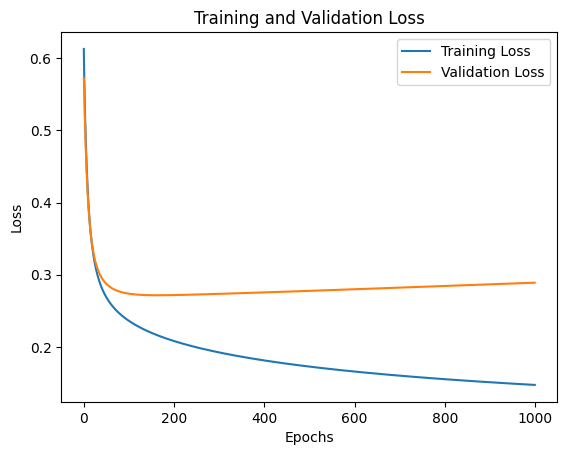

In [194]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [195]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [196]:
y_predicted = predict(x_train, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [197]:
y_train.shape

(533,)

In [198]:
y_train.reshape(-1).shape, y_predicted.shape

((533,), (533,))

In [199]:
(y_train.reshape(-1) == y_predicted).sum()

np.int64(507)

In [200]:
y_train = y_train.reshape(-1)

In [201]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [202]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 95.12% 
 Precision: 91.67% 
 Recall: 72.37% 
 F1 Score: 80.88% 
 Specificity: 98.91% 
 False Positive Rate: 1.09% 
 False Negative Rate: 27.63%


In [203]:
y_predicted_validation = predict(x_validation, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_18164\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [204]:
y_validation = y_validation.reshape(-1)

In [205]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [244]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 89.55% 
 Precision: 77.78% 
 Recall: 36.84% 
 F1 Score: 50.00% 
 Specificity: 98.26% 
 False Positive Rate: 1.74% 
 False Negative Rate: 63.16%


### Analyze the feature importance

<Axes: ylabel='Feature'>

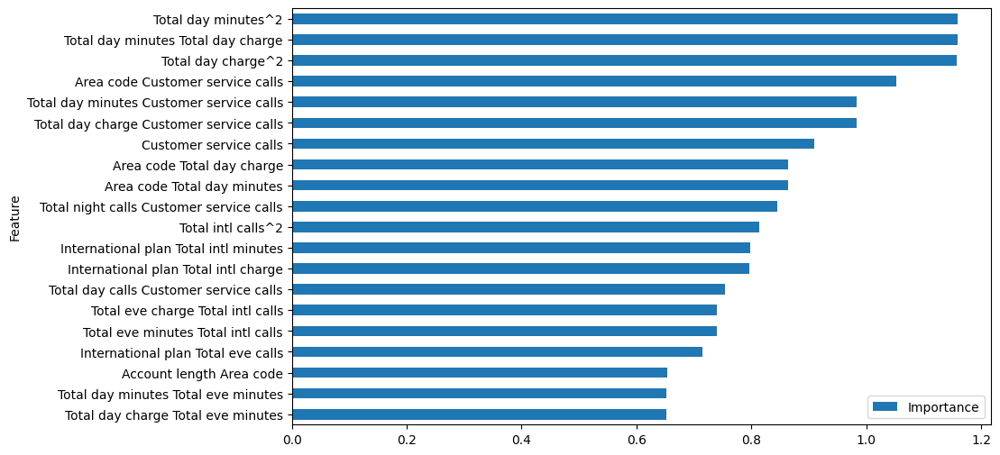

In [207]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.tail(20).plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

#### For example most important feature is obtained by multipling two features: Total day minutes and Customer service calls

### Decision Tree 
#### Specialized in learning non-linear data
#### No need for Normalization/Standardization
#### No need for Polynomial Feature Transformation

In [245]:
x_data = data.drop(columns=['Churn'])

### Split data into training and validation datasets: Default 80% train, 20% validation

In [246]:
x_train, x_validation, y_train, y_validation = train_test_split(x_data, y_data, test_size=0.2, random_state=42, stratify=y_data)

In [248]:
x_train = x_train.to_numpy()
x_validation = x_validation.to_numpy()
y_train = y_train.to_numpy()
y_validation = y_validation.to_numpy()

### Visualize how one sample looks like

In [249]:
x_train[0]

array([ 32.  , 178.  , 415.  ,   0.  ,   1.  ,  35.  , 175.4 ,  88.  ,
        29.82, 190.  ,  65.  ,  16.15, 138.7 ,  94.  ,   6.24,  10.5 ,
         3.  ,   2.84,   2.  ])

### Visualize the nuber of training samples and number of validation samples

In [250]:
len(y_train), len(y_validation)

(533, 134)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [251]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([457,  76]))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [252]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([115,  19]))

In [275]:
from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn.metrics import accuracy_score

### Decision Tree Code and Implementation

#### Declare Decision Tree with corresponding Hyperparameters

In [276]:
classifier = DecisionTreeClassifier(criterion='entropy', min_samples_split=2, max_depth=5)

In [277]:
type(x_train)

numpy.ndarray

#### Train the Decision Tree

In [278]:
classifier.fit(x_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=5)

#### Predict on the training dataset 

In [279]:
y_predicted = classifier.predict(x_train)
y_predicted = np.array(y_predicted)

### Display training metrics

In [280]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train.reshape(-1),
                                                                                                                     y_predicted=y_predicted)

In [281]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 97.19% 
 Precision: 95.52% 
 Recall: 84.21% 
 F1 Score: 89.51% 
 Specificity: 99.34% 
 False Positive Rate: 0.66% 
 False Negative Rate: 15.79%


### Display validation metrics

In [282]:
y_predicted_valid = classifier.predict(x_validation)
y_predicted_valid = np.array(y_predicted_valid)

In [283]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation.reshape(-1),
                                                                                                                     y_predicted=y_predicted_valid)

In [284]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 93.28% 
 Precision: 77.78% 
 Recall: 73.68% 
 F1 Score: 75.68% 
 Specificity: 96.52% 
 False Positive Rate: 3.48% 
 False Negative Rate: 26.32%


### Display Decision Tree and Learned rules by the Tree 

In [285]:
list(x_data.columns)

['State',
 'Account length',
 'Area code',
 'International plan',
 'Voice mail plan',
 'Number vmail messages',
 'Total day minutes',
 'Total day calls',
 'Total day charge',
 'Total eve minutes',
 'Total eve calls',
 'Total eve charge',
 'Total night minutes',
 'Total night calls',
 'Total night charge',
 'Total intl minutes',
 'Total intl calls',
 'Total intl charge',
 'Customer service calls']

In [290]:
from sklearn.tree import plot_tree


In [292]:
fig, axes = plt.subplots(nrows = 1,ncols = 1, figsize=(70,50), dpi=300)
plot_tree(classifier, filled=True, fontsize=20, feature_names=list(x_data.columns),rounded=True, ax=axes)
plt.savefig('decisionTree.png')

In [294]:
text_representation = export_text(classifier, feature_names=list(x_data.columns), class_names=['No Churn', 'Churn'])
print(text_representation)

|--- Total day minutes <= 246.80
|   |--- Customer service calls <= 3.50
|   |   |--- International plan <= 0.50
|   |   |   |--- Total eve charge <= 22.74
|   |   |   |   |--- Total intl charge <= 2.39
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total intl charge >  2.39
|   |   |   |   |   |--- class: No Churn
|   |   |   |--- Total eve charge >  22.74
|   |   |   |   |--- Total day minutes <= 219.90
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total day minutes >  219.90
|   |   |   |   |   |--- class: Churn
|   |   |--- International plan >  0.50
|   |   |   |--- Total intl calls <= 2.50
|   |   |   |   |--- class: Churn
|   |   |   |--- Total intl calls >  2.50
|   |   |   |   |--- Total intl minutes <= 13.00
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total intl minutes >  13.00
|   |   |   |   |   |--- class: Churn
|   |--- Customer service calls >  3.50
|   |   |--- Total day charge <= 27.49
|   |   |   |--- Total eve minutes

In [299]:
from sklearn.tree import _tree

In [300]:
def get_rules(tree, feature_names, class_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    paths = []
    path = []
    
    def recurse(node, path, paths):
        
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            p1, p2 = list(path), list(path)
            p1 += [f"({name} <= {np.round(threshold, 3)})"]
            recurse(tree_.children_left[node], p1, paths)
            p2 += [f"({name} > {np.round(threshold, 3)})"]
            recurse(tree_.children_right[node], p2, paths)
        else:
            path += [(tree_.value[node], tree_.n_node_samples[node])]
            paths += [path]
            
    recurse(0, path, paths)

    # sort by samples count
    samples_count = [p[-1][1] for p in paths]
    ii = list(np.argsort(samples_count))
    paths = [paths[i] for i in reversed(ii)]
    
    rules = []
    for path in paths:
        rule = "if "
        
        for p in path[:-1]:
            if rule != "if ":
                rule += " and "
            rule += str(p)
        rule += " then "
        if class_names is None:
            rule += "response: "+str(np.round(path[-1][0][0][0],3))
        else:
            classes = path[-1][0][0]
            l = np.argmax(classes)
            rule += f"class: {class_names[l]} (proba: {np.round(100.0*classes[l]/np.sum(classes),2)}%)"
        rule += f" | based on {path[-1][1]:,} samples"
        rules += [rule]
        
    return rules

In [301]:
rules = get_rules(classifier, feature_names=list(x_data.columns), class_names=['No Churn', 'Churn'])
for r in rules:
    print(r)

if (Total day minutes <= 246.8) and (Customer service calls <= 3.5) and (International plan <= 0.5) and (Total eve charge <= 22.74) and (Total intl charge > 2.39) then class: No Churn (proba: 97.28%) | based on 257 samples
if (Total day minutes <= 246.8) and (Customer service calls <= 3.5) and (International plan <= 0.5) and (Total eve charge <= 22.74) and (Total intl charge <= 2.39) then class: No Churn (proba: 100.0%) | based on 111 samples
if (Total day minutes <= 246.8) and (Customer service calls <= 3.5) and (International plan <= 0.5) and (Total eve charge > 22.74) and (Total day minutes <= 219.9) then class: No Churn (proba: 88.46%) | based on 26 samples
if (Total day minutes <= 246.8) and (Customer service calls <= 3.5) and (International plan > 0.5) and (Total intl calls > 2.5) and (Total intl minutes <= 13.0) then class: No Churn (proba: 95.45%) | based on 22 samples
if (Total day minutes > 246.8) and (Number vmail messages <= 5.5) and (Total eve charge > 15.29) and (Total da